In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import ProfileReport
from datetime import datetime
from sklearn.model_selection import KFold,StratifiedKFold,GridSearchCV,RandomizedSearchCV, train_test_split #For splitting

ModuleNotFoundError: No module named 'pandas_profiling'

In [3]:
test = pd.read_csv('Test.csv')
test.head()

,ID,Year_of_Birth,Education_Level,Marital_Status,Disposable_Income,No_of_Kids_in_home,No_of_Teen_in_home,Date_Customer,Recency,Discounted_Purchases,...,Amount_on_FishProducts,Amount_on_SweetProducts,Amount_on_GoldProds,WebVisitsMonth,Cmp3Accepted,Cmp4Accepted,Cmp5Accepted,Cmp1Accepted,Cmp2Accepted,Any_Complain
0,ID_ZPMABNVX,1954,Graduation,Single,48556.8,0,1,11-01-2013,85,6,...,7,23,41,8,0,0,0,0,0,0
1,ID_WFE91NAA,1961,Graduation,Widow,57499.2,0,1,22-11-2012,79,5,...,0,0,75,6,0,1,0,0,0,0
2,ID_JV11RBRK,1973,Basic,Married,17025.6,0,0,28-02-2013,47,1,...,16,12,27,6,0,0,0,0,0,0
3,ID_6B7SVKY9,1970,Graduation,Together,91983.6,0,0,16-08-2013,98,1,...,219,189,126,2,0,0,1,1,0,0
4,ID_GOVUZ545,1959,Graduation,Together,78235.2,0,2,25-07-2013,41,2,...,12,0,200,5,1,0,0,0,0,0


In [4]:
print(f'The test dataset consist of {test.shape[0]} rows and {test.shape[1]} columns')

The test dataset consist of 672 rows and 26 columns


In [5]:
print(f'The features are {test.columns}')

The features are Index(['ID', 'Year_of_Birth', 'Education_Level', 'Marital_Status',
       'Disposable_Income', 'No_of_Kids_in_home', 'No_of_Teen_in_home',
       'Date_Customer', 'Recency', 'Discounted_Purchases', 'WebPurchases',
       'CatalogPurchases', 'StorePurchases', 'Amount_on_Wines',
       'Amount_on_Fruits', 'Amount_on_MeatProducts', 'Amount_on_FishProducts',
       'Amount_on_SweetProducts', 'Amount_on_GoldProds', 'WebVisitsMonth',
       'Cmp3Accepted', 'Cmp4Accepted', 'Cmp5Accepted', 'Cmp1Accepted',
       'Cmp2Accepted', 'Any_Complain'],
      dtype='object')


In [5]:
profile = ProfileReport(test, title="Pandas Profiling Report")
profile

<AxesSubplot:>

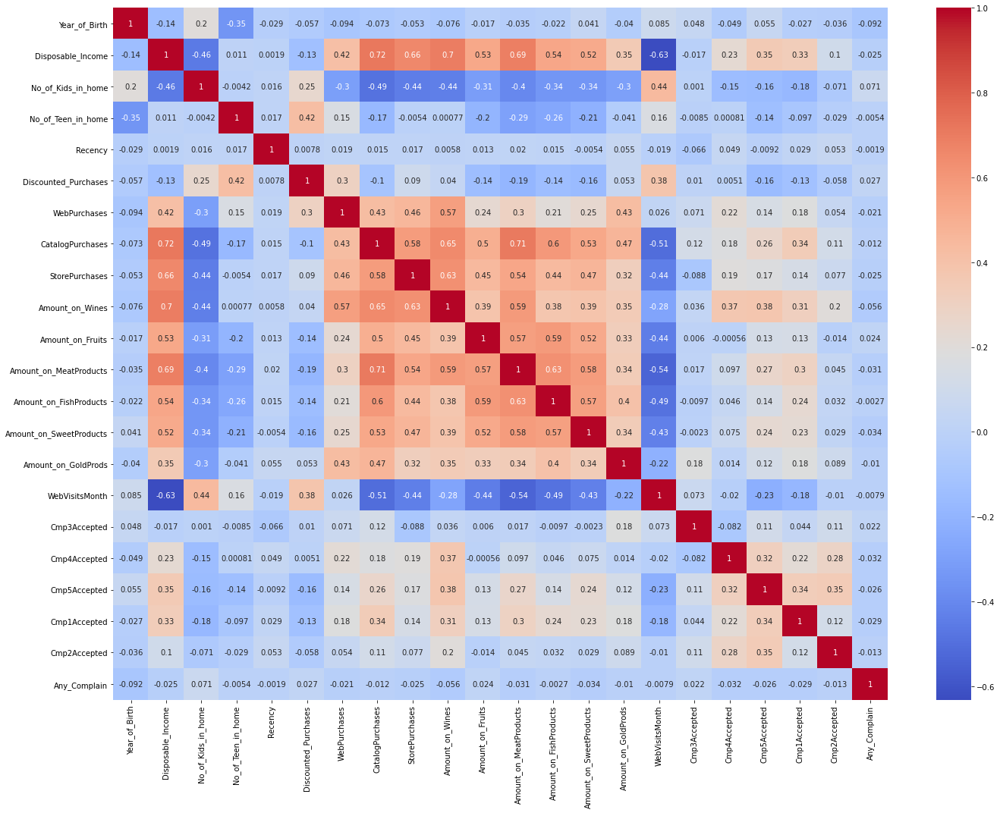

In [6]:
plt.figure(figsize = (20,15), tight_layout = True)
sns.heatmap(test.corr(), annot = True, cmap = 'coolwarm')

## Data Cleaning

In [8]:
sns.heatmap(test.isnull(),yticklabels = False,cbar =False, cmap = 'inferno')

<AxesSubplot:>

In [9]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 672 entries, 0 to 671
Data columns (total 26 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   ID                       672 non-null    object 
 1   Year_of_Birth            672 non-null    int64  
 2   Education_Level          672 non-null    object 
 3   Marital_Status           672 non-null    object 
 4   Disposable_Income        664 non-null    float64
 5   No_of_Kids_in_home       672 non-null    int64  
 6   No_of_Teen_in_home       672 non-null    int64  
 7   Date_Customer            672 non-null    object 
 8   Recency                  672 non-null    int64  
 9   Discounted_Purchases     672 non-null    int64  
 10  WebPurchases             672 non-null    int64  
 11  CatalogPurchases         672 non-null    int64  
 12  StorePurchases           672 non-null    int64  
 13  Amount_on_Wines          672 non-null    int64  
 14  Amount_on_Fruits         6

Our Disposable Income feature has missing values according to our heatmap and info table, lets use a mini linear regression model to predict and fill in the missing values. 

### Mini Linear Regression Model to Predict Disposable Income Values

first lets check for the first 4 features that are correlated to the feature `Disposable Income`.

In [10]:
test.corr().loc['Disposable_Income',:].sort_values(ascending=False).to_frame()

,Disposable_Income
Disposable_Income,1.000000
CatalogPurchases,0.715101
Amount_on_Wines,0.700044
Amount_on_MeatProducts,0.688405
StorePurchases,0.657171
Amount_on_FishProducts,0.535955
Amount_on_Fruits,0.529021
Amount_on_SweetProducts,0.516817
WebPurchases,0.417789
Amount_on_GoldProds,0.351005


from the table above, we can see that the features that correlate most are the `CatalogPurchases`,`Amount_on_Wines`, `Amount_on_MeatProducts`, and `StorePurchases`. 

In [9]:
from sklearn.linear_model import LinearRegression

Lr  = LinearRegression()

#setting our predictor variables
to_train = ['Disposable_Income','CatalogPurchases','Amount_on_Wines','Amount_on_MeatProducts','StorePurchases']
train_df = test[to_train]


#splitting the data
x_train = train_df[train_df['Disposable_Income'].notnull()].drop(columns = 'Disposable_Income')
y_train = train_df[train_df['Disposable_Income'].notnull()]['Disposable_Income']
x_test = train_df[train_df['Disposable_Income'].isnull()].drop(columns = 'Disposable_Income')


Lr.fit(x_train,y_train)
pred = Lr.predict(x_test)

print(np.round(pred,1))     

[52290.6 47099.4 57697.5 56202.9 41341.3 42383.3 39227.7 39237.2]


In [10]:
##filling the values
test['Disposable_Income'][test['Disposable_Income'].isnull()] = pred

<ipython-input-10-22f1142ad877>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test['Disposable_Income'][test['Disposable_Income'].isnull()] = pred


In [11]:
test.isnull().sum()

ID                         0
Year_of_Birth              0
Education_Level            0
Marital_Status             0
Disposable_Income          0
No_of_Kids_in_home         0
No_of_Teen_in_home         0
Date_Customer              0
Recency                    0
Discounted_Purchases       0
WebPurchases               0
CatalogPurchases           0
StorePurchases             0
Amount_on_Wines            0
Amount_on_Fruits           0
Amount_on_MeatProducts     0
Amount_on_FishProducts     0
Amount_on_SweetProducts    0
Amount_on_GoldProds        0
WebVisitsMonth             0
Cmp3Accepted               0
Cmp4Accepted               0
Cmp5Accepted               0
Cmp1Accepted               0
Cmp2Accepted               0
Any_Complain               0
dtype: int64

In [12]:
test.duplicated().sum()

0

<AxesSubplot:>

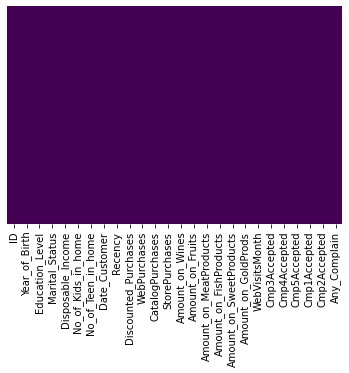

In [13]:
sns.heatmap(test.isnull(),yticklabels = False,cbar =False, cmap = 'viridis')

In [14]:
test['Education_Level'].replace('2n Cycle','Secondary',inplace=True)

In [15]:
for i in test.columns:
    print(test[i].unique())

['ID_ZPMABNVX' 'ID_WFE91NAA' 'ID_JV11RBRK' 'ID_6B7SVKY9' 'ID_GOVUZ545'
 'ID_A3SFW973' 'ID_HERGG0GD' 'ID_S36UV4BY' 'ID_9E10P1ZZ' 'ID_2840OCS5'
 'ID_JCTOSHNK' 'ID_9LLVM41O' 'ID_TDCG3QVS' 'ID_2RE3UL3M' 'ID_62X1U1Q9'
 'ID_79N73FHZ' 'ID_CUSB2F0K' 'ID_9EAC9BLH' 'ID_KQNSDF1S' 'ID_30PH2BQB'
 'ID_1ROZENIZ' 'ID_14DP6I2K' 'ID_YBNSBULG' 'ID_EN6J3AN0' 'ID_YLNY205A'
 'ID_JN69O071' 'ID_HMQNRSKW' 'ID_94W19YVD' 'ID_3QFCADD4' 'ID_7SQGAJEV'
 'ID_ORL3J2MS' 'ID_ZZP16F3C' 'ID_F1OA5IFK' 'ID_88ZZH3F8' 'ID_ECUNIT20'
 'ID_BSF2BAKD' 'ID_2VMFU08P' 'ID_F49IFMQZ' 'ID_S86IE9EC' 'ID_LXLOIXGQ'
 'ID_QCJ01BWI' 'ID_MOW0IJ2P' 'ID_YP1AKCV3' 'ID_KVSACQLG' 'ID_11N5AFNU'
 'ID_IQZYXI8F' 'ID_36930STY' 'ID_D89BUNFW' 'ID_7BGL0ZAA' 'ID_F1GDNP7N'
 'ID_Q2XRKOZL' 'ID_BHN7VSWC' 'ID_8429NU7K' 'ID_I2DHJB1L' 'ID_WKHK4001'
 'ID_5OBUZA1O' 'ID_41LLBNJQ' 'ID_KEOWXCCD' 'ID_0KMNSZWV' 'ID_UTLEFRXM'
 'ID_16MG7LYH' 'ID_H24QJ2Q8' 'ID_NBFRZBCE' 'ID_XGLL6MQE' 'ID_3JEDHRBP'
 'ID_DYG2GME5' 'ID_D0KRDI51' 'ID_LK6SIOEA' 'ID_XPY9XDOP' 'ID_2OTU72O6'
 'ID_K

In [16]:
test.head()

,ID,Year_of_Birth,Education_Level,Marital_Status,Disposable_Income,No_of_Kids_in_home,No_of_Teen_in_home,Date_Customer,Recency,Discounted_Purchases,...,Amount_on_FishProducts,Amount_on_SweetProducts,Amount_on_GoldProds,WebVisitsMonth,Cmp3Accepted,Cmp4Accepted,Cmp5Accepted,Cmp1Accepted,Cmp2Accepted,Any_Complain
0,ID_ZPMABNVX,1954,Graduation,Single,48556.8,0,1,11-01-2013,85,6,...,7,23,41,8,0,0,0,0,0,0
1,ID_WFE91NAA,1961,Graduation,Widow,57499.2,0,1,22-11-2012,79,5,...,0,0,75,6,0,1,0,0,0,0
2,ID_JV11RBRK,1973,Basic,Married,17025.6,0,0,28-02-2013,47,1,...,16,12,27,6,0,0,0,0,0,0
3,ID_6B7SVKY9,1970,Graduation,Together,91983.6,0,0,16-08-2013,98,1,...,219,189,126,2,0,0,1,1,0,0
4,ID_GOVUZ545,1959,Graduation,Together,78235.2,0,2,25-07-2013,41,2,...,12,0,200,5,1,0,0,0,0,0


In [17]:
test.dtypes

ID                          object
Year_of_Birth                int64
Education_Level             object
Marital_Status              object
Disposable_Income          float64
No_of_Kids_in_home           int64
No_of_Teen_in_home           int64
Date_Customer               object
Recency                      int64
Discounted_Purchases         int64
WebPurchases                 int64
CatalogPurchases             int64
StorePurchases               int64
Amount_on_Wines              int64
Amount_on_Fruits             int64
Amount_on_MeatProducts       int64
Amount_on_FishProducts       int64
Amount_on_SweetProducts      int64
Amount_on_GoldProds          int64
WebVisitsMonth               int64
Cmp3Accepted                 int64
Cmp4Accepted                 int64
Cmp5Accepted                 int64
Cmp1Accepted                 int64
Cmp2Accepted                 int64
Any_Complain                 int64
dtype: object

In [18]:
test.to_csv('testdf.csv',index=False)

In [25]:
round(test.describe(),2).T

,count,mean,std,min,25%,50%,75%,max
Year_of_Birth,672.0,1969.18,12.12,1894.0,1960.00,1970.0,1978.00,1997.0
Disposable_Income,672.0,63237.75,25201.05,5313.6,44113.80,63490.8,83207.10,194876.4
No_of_Kids_in_home,672.0,0.41,0.53,0.0,0.00,0.0,1.00,2.0
No_of_Teen_in_home,672.0,0.53,0.55,0.0,0.00,1.0,1.00,2.0
Recency,672.0,57.74,29.32,7.0,33.00,58.0,84.00,106.0
Discounted_Purchases,672.0,2.40,1.92,0.0,1.00,2.0,3.00,15.0
WebPurchases,672.0,4.28,2.78,0.0,2.00,4.0,6.00,25.0
CatalogPurchases,672.0,2.65,2.62,0.0,1.00,2.0,4.00,11.0
StorePurchases,672.0,5.99,3.22,0.0,3.00,5.0,8.00,13.0
Amount_on_Wines,672.0,322.34,328.04,5.0,35.75,209.5,514.75,1483.0
